In [2]:
"""
Link to the kaggle data: https://www.kaggle.com/datasets/robikscube/driving-video-with-object-tracking/data
Link to the data processing tutorial: https://www.kaggle.com/code/robikscube/working-with-video-in-python-youtube-tutorial
"""

'\nLink to the kaggle data: https://www.kaggle.com/datasets/robikscube/driving-video-with-object-tracking/data\nLink to the data processing tutorial: https://www.kaggle.com/code/robikscube/working-with-video-in-python-youtube-tutorial\n'

In [3]:
from pathlib import Path
import os
from glob import glob
import subprocess

import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt

import IPython.display as ipd
from tqdm import tqdm

In [4]:
Path.cwd()

WindowsPath('c:/Proyectos/George Brown Projects/2 Semester/Deep Learning 2/RetinaDet - Video with obj traking/Notebooks')

Relative path where the data videos are stored:

In [5]:
relat_path_vids = Path(r"..\Data\bdd100k_videos_train_00\bdd100k\videos\train") # Relative path where the videos are stored.
relat_path_vids

WindowsPath('../Data/bdd100k_videos_train_00/bdd100k/videos/train')

---
## Metadata Exploration

In [6]:
data = pd.read_parquet("../Data/mot_labels.parquet")
display(ipd.Markdown('### Metadata of the whole 1000 videos:'))
data

### Metadata of the whole 1000 videos:

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo
0,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,00089537,car,False,True,False,825.173210,1003.094688,355.011547,418.198614,True
1,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,00089538,car,False,True,False,484.295612,700.461894,346.697460,424.849885,True
2,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,00089539,pedestrian,False,True,False,645.588915,663.879908,338.383372,358.337182,True
3,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,00089540,car,False,False,False,120.969977,192.471132,359.168591,409.053118,True
4,01c71072-718028b8-0000001.jpg,01c71072-718028b8,0,00089541,car,False,False,False,251.501155,315.519630,354.180139,400.739030,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2890841,00adbb3f-7757d4ea-0000202.jpg,00adbb3f-7757d4ea,201,00070587,car,False,True,False,105.312994,169.282443,451.341401,500.152672,True
2890842,00adbb3f-7757d4ea-0000202.jpg,00adbb3f-7757d4ea,201,00070591,car,False,True,False,312.328249,368.244275,460.368229,490.457656,True
2890843,00adbb3f-7757d4ea-0000202.jpg,00adbb3f-7757d4ea,201,00070593,car,False,True,False,368.533042,414.700981,467.384253,491.059444,True
2890844,00adbb3f-7757d4ea-0000202.jpg,00adbb3f-7757d4ea,201,00070581,car,False,True,False,0.524781,111.778426,446.064140,500.641399,True


In [7]:
categ_count = data['category'].value_counts(dropna=False)

classes_df = pd.DataFrame({
    'Count': categ_count.values,
    'Percentage': ((categ_count / len(data)) * 100).round(2)
})
classes_df

,Count,Percentage
category,,
car,2207116,76.35
pedestrian,381441,13.19
truck,149823,5.18
bus,57880,2.00
bicycle,28477,0.99
rider,20365,0.70
other vehicle,19202,0.66
motorcycle,12464,0.43
other person,4453,0.15


In [8]:
""" This method is just for visualization. It does 3 things:
    1. Filters the data with all the missing annotations.
    2. Counts the number of videos with at least one missing annotation.
    3. Group by videoName, showing the number of missings and the corresponding frameIndexes. """
    
def miss_annotations_df(data : pd.DataFrame) -> None: 
    
    # Data with missing annotations (in category).
    miss_annot = data[data.category.isna()]
    display(miss_annot)

    # Videos with missing annotations.
    miss_annot_vids = miss_annot.videoName.unique()
    display(ipd.Markdown(f'### There is {len(miss_annot_vids)} videos with missing annotations:'))

    # DataFrame missing annotations per video.
    records = []
    for vid_name, grp in miss_annot.groupby(['videoName']):
        amount_miss = len(grp)
        frame_index = grp['frameIndex'].values
        records.append({
            'videoName': vid_name,
            '#_missing': amount_miss,
            'frameIndex': frame_index
        })
    display(pd.DataFrame(records))

#### The missing annotations are frames in which there is no objets detected. We will see this at the end of the notebook:

In [9]:
miss_annotations_df(data)

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo
92404,0232c9f2-2ca912f6-0000169.jpg,0232c9f2-2ca912f6,168,None,None,None,None,None,NaN,NaN,NaN,NaN,True
114454,019cd27a-b3c5617d-0000038.jpg,019cd27a-b3c5617d,37,None,None,None,None,None,NaN,NaN,NaN,NaN,True
114455,019cd27a-b3c5617d-0000039.jpg,019cd27a-b3c5617d,38,None,None,None,None,None,NaN,NaN,NaN,NaN,True
114456,019cd27a-b3c5617d-0000040.jpg,019cd27a-b3c5617d,39,None,None,None,None,None,NaN,NaN,NaN,NaN,True
114457,019cd27a-b3c5617d-0000041.jpg,019cd27a-b3c5617d,40,None,None,None,None,None,NaN,NaN,NaN,NaN,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2884381,0081e3ea-3f7b0282-0000087.jpg,0081e3ea-3f7b0282,86,None,None,None,None,None,NaN,NaN,NaN,NaN,True
2884382,0081e3ea-3f7b0282-0000088.jpg,0081e3ea-3f7b0282,87,None,None,None,None,None,NaN,NaN,NaN,NaN,True
2884383,0081e3ea-3f7b0282-0000089.jpg,0081e3ea-3f7b0282,88,None,None,None,None,None,NaN,NaN,NaN,NaN,True
2884384,0081e3ea-3f7b0282-0000090.jpg,0081e3ea-3f7b0282,89,None,None,None,None,None,NaN,NaN,NaN,NaN,True


### There is 197 videos with missing annotations:

,videoName,#_missing,frameIndex
0,"(0000f77c-62c2a288,)",16,"[71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 8..."
1,"(0001542f-7c670be8,)",3,"[139, 140, 141]"
2,"(00054602-3bf57337,)",51,"[54, 55, 56, 144, 145, 146, 147, 148, 149, 150..."
3,"(0008a165-c48f4b3e,)",19,"[172, 173, 174, 175, 176, 177, 178, 179, 180, ..."
4,"(000d4f89-3bcbe37a,)",30,"[97, 98, 99, 100, 101, 102, 103, 104, 105, 106..."
...,...,...,...
192,"(03adba3a-eea89633,)",32,"[154, 155, 156, 157, 158, 175, 176, 177, 178, ..."
193,"(03b540ad-9e70a0ad,)",16,"[37, 38, 163, 164, 165, 166, 167, 168, 169, 17..."
194,"(03c239e4-54df0d61,)",6,"[36, 37, 47, 48, 49, 50]"
195,"(03d34d05-4a61174c,)",5,"[112, 113, 114, 115, 116]"


In [10]:

""" This function rebuilds the relative path to each video file given its name. """

def video_full_path(vid_name : str, format : str) -> Path:
    return (relat_path_vids / f"{vid_name}.{format}")

ex1 = data["videoName"].iloc[0]
video_full_path(ex1, 'mov')

WindowsPath('../Data/bdd100k_videos_train_00/bdd100k/videos/train/01c71072-718028b8.mov')

---
## Video Data Exploration

In [11]:
""" This function checks which videos are available in the videos data folder. """
def available_videos(folder : Path) -> list:
    return [p.name[:-4] for p in folder.iterdir() if p.is_file()] # [:-4] is to removes the .mov extension

available_videos(relat_path_vids)

['00a04f65-8c891f94',
 '00a04f65-af2ab984',
 '00a0f008-3c67908e',
 '00a0f008-a315437f',
 '00a2e3ca-5c856cde',
 '00a2e3ca-62992459',
 '00a2f5b6-d4217a96',
 '00a395fe-d60c0b47',
 '00a820ef-2b98dcf5',
 '00a9cd6b-b39be004']

In [12]:
# given the list of available videos, filter the dataframe to only include those videos
available_vids = available_videos(relat_path_vids)
data = data[data["videoName"].isin(available_vids)].reset_index(drop=True)
display(ipd.Markdown('### Actual Data Available:'))
data

### Actual Data Available:

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo
0,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000512,car,False,False,False,491.778291,717.090069,320.923788,512.147806,True
1,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000513,car,False,False,True,928.267898,1279.538106,298.475751,571.177829,True
2,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000514,car,False,True,False,816.027714,1029.699769,347.528868,474.734411,True
3,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000515,car,False,True,False,811.870670,948.221709,325.912240,408.221709,True
4,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000516,car,False,True,False,673.025404,751.177829,325.080831,367.482679,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24701,00a820ef-2b98dcf5-0000202.jpg,00a820ef-2b98dcf5,201,00095269,car,False,True,False,309.096210,339.119090,362.636929,398.093633,True
24702,00a820ef-2b98dcf5-0000202.jpg,00a820ef-2b98dcf5,201,00095268,car,False,False,False,666.485325,698.489124,363.695173,389.627681,True
24703,00a820ef-2b98dcf5-0000202.jpg,00a820ef-2b98dcf5,201,00095227,car,False,False,False,331.510791,426.474820,344.652312,411.798561,True
24704,00a820ef-2b98dcf5-0000202.jpg,00a820ef-2b98dcf5,201,00095223,car,True,True,False,561.616628,661.385681,349.943532,384.110855,True


In [13]:
count_vids = data.videoName.nunique()
display(ipd.Markdown(f"Number of videos available for processing: {count_vids}<br><br>"))

# Number of LABELLED FRAMES per video. Not all the frames of the videos have metadata, just around 1 out of 6.
labelled_frames = data.groupby("videoName")["name"].nunique().reset_index().rename(columns={"name": "LabelledFramesPerVideo"})
labelled_frames

Number of videos available for processing: 10<br><br>

,videoName,LabelledFramesPerVideo
0,00a04f65-8c891f94,203
1,00a04f65-af2ab984,202
2,00a0f008-3c67908e,202
3,00a0f008-a315437f,203
4,00a2e3ca-5c856cde,202
5,00a2e3ca-62992459,202
6,00a2f5b6-d4217a96,202
7,00a395fe-d60c0b47,203
8,00a820ef-2b98dcf5,202
9,00a9cd6b-b39be004,203


---
## Convert videos from .mov format to .mp4:

In [14]:
""" Convert a .mov video file to .mp4 format using ffmpeg. 
    input_path (str): Path to the input .mov file.
    output_path (str): Path to save the output .mp4 file. """
def convert_to_mp4(input_path: Path, output_path: Path) -> None: # type hints, telling the expected data types is none.
    cmd = [
        "ffmpeg",               # indicates that ffmpeg will be the video conversion tool. (https://ffmpeg.org/ffmpeg.html)  
        "-n",                   # -n indicates to skip if the output file already exists.
        "-i", str(input_path),  # -i indicates input file.    
        "-c", "copy",           # -c copy tells ffmpeg to copy the video and audio streams without re-encoding them.
        str(output_path)        # the name of the new file to be created.
    ]
    subprocess.run(cmd, check=True)
    
""" Uses convert_to_mp4() to convert several videos contained in a folder. """
def batch_convert(folder_path: Path) -> None:
    for mov_file in folder_path.glob("*.mov"):  # glob() looks for files matching that pattern.
        mp4_file = mov_file.with_suffix(".mp4") # with_suffix() replaces the extension of a file.
        convert_to_mp4(mov_file, mp4_file)


""" Delete .mov files if .mp4 exists. """
def delete_movs(folder_path: Path):
    for mov in folder_path.glob("*.mov"):
        mp4 = mov.with_suffix(".mp4")
        
        if mp4.exists():
            print(f"Delete {mov.name}, {mp4.name} already exists.")
            mov.unlink()  # delete the .mov file
        else:
            print(f"Not deleted {mov.name}: mp4 does not exist.")

In [15]:
""" Run one time. Convert all the videos from .mov to .mp4 format. """
# batch_convert(relat_path_vids)
# delete_movs(relat_path_vids)
# available_videos(path_base_vid)

' Run one time. Convert all the videos from .mov to .mp4 format. '

---
## Display video in the notebook:

In [16]:
sample_vid_path = video_full_path(data.videoName.iloc[0], 'mp4') # This is gonna be the video for examples.

In [17]:
""" Display a video in the notebook: """

def display_video(video_path : Path) -> None:
    display(ipd.Markdown(f'#### **Video being display:** {video_path}'))
    display(ipd.Video(filename=video_path, width=600))
    
display_video(sample_vid_path) # Just an example with the first video.

#### **Video being display:** ..\Data\bdd100k_videos_train_00\bdd100k\videos\train\00a2e3ca-5c856cde.mp4

--
## Opening videos using cv2.VideoCapture and the metadata:

In [18]:
capture = cv2.VideoCapture(sample_vid_path) # capture is an object that allows us to capture frames from a video.

print(f"Total number of frames in the video: {int(capture.get(cv2.CAP_PROP_FRAME_COUNT))}")
print(f"Frame width: {capture.get(cv2.CAP_PROP_FRAME_WIDTH)}")
print(f"Frame height: {capture.get(cv2.CAP_PROP_FRAME_HEIGHT)}")
print(f"Frame rate: {capture.get(cv2.CAP_PROP_FPS):0.2f}")
# video length in seconds:
print(f"Video length (seconds): {int(capture.get(cv2.CAP_PROP_FRAME_COUNT)) / capture.get(cv2.CAP_PROP_FPS)}")

capture.release()

Total number of frames in the video: 1205
Frame width: 1280.0
Frame height: 720.0
Frame rate: 30.05
Video length (seconds): 40.095


This confirms that not all frames are **labelled** in the metadata. The total video has 1205 frames, but only 203 are labelled (we saw that above).

---
# Pulling images from the video:

In [19]:
capture = cv2.VideoCapture(sample_vid_path)
ret, img = capture.read()
capture.release()
print(f'Returned: {ret}, Image shape: {img.shape}') # ret is gonna be True until the last frame is reached.

Returned: True, Image shape: (720, 1280, 3)


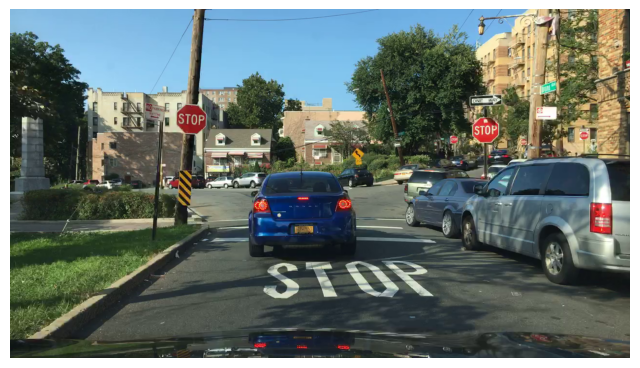

In [20]:
""" To display a cv2 image, the colors need to be converted from BGR to RGB. """
def display_cv2_image(img, figsize=(8, 8)) -> None:
    img_ = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    plt.figure(figsize=figsize)
    plt.imshow(img_)
    plt.axis('off')  # Hide axis
    plt.show()
    
display_cv2_image(img)
capture.release()

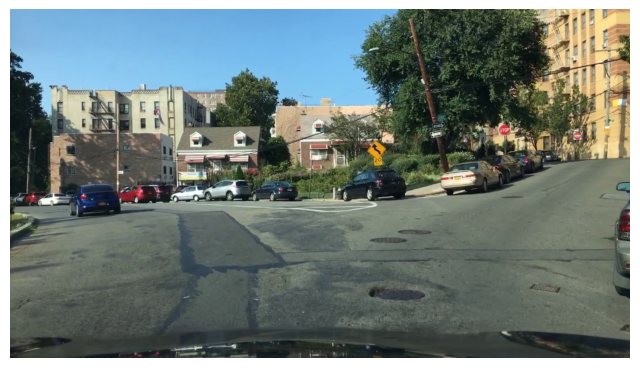

In [21]:
""" Return a specific frame given the video name and the frame index. """
def get_frame( video_name : str, frame_index : int) -> np.ndarray:
    vid_path = video_full_path(video_name, 'mp4')
    capture = cv2.VideoCapture(vid_path)
    capture.set(cv2.CAP_PROP_POS_FRAMES, frame_index) # Set the frames pointer to the desired frame index.
    _, img = capture.read()
    capture.release()
    return img

frame = get_frame(data.videoName.iloc[0], 200)
display_cv2_image(frame)

In [22]:
""" This function returns a list of the frames within a given range, from a video. """
def get_frames_in_range(vid_name : str, begin : int, end : int) -> list:
    vid_path = video_full_path(vid_name, 'mp4')
    capture = cv2.VideoCapture(vid_path)
    frames = []
    capture.set(cv2.CAP_PROP_POS_FRAMES, begin) # Set the frames pointer to the begin index.
    for _ in range(begin, end+1): # includes the first and last frame.
            ret, img = capture.read()
            frames.append(img)
            if not ret:
                print("End of video reached, range given exceeds video length.")
                break
    capture.release()
    return frames

#### Let's plot the results:

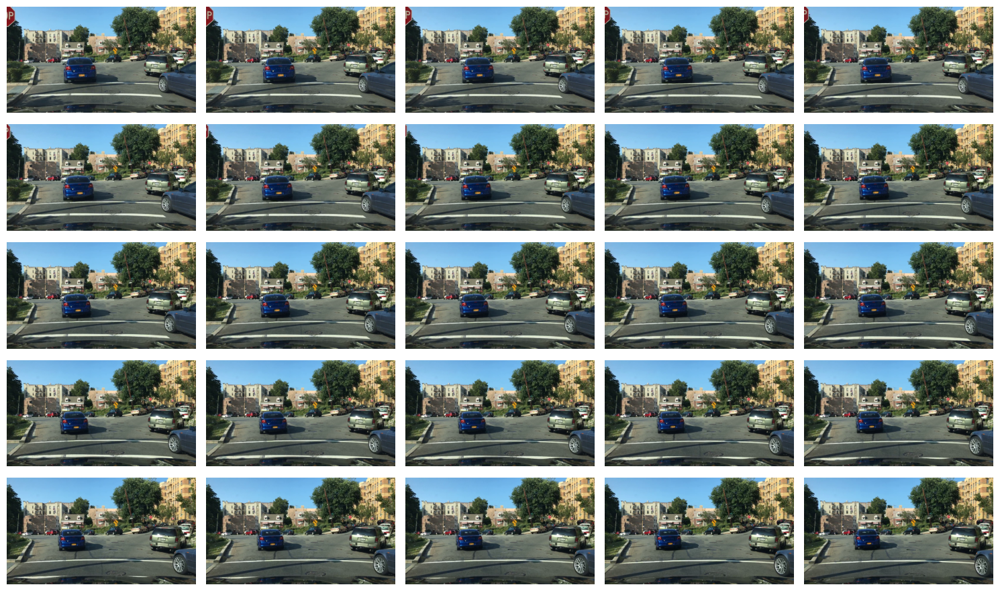

In [23]:
""" This function draws multiple frames in a grid layout of variable size accoding to the arguments given. """

def multiple_frames_plot(list_of_frames: list, cols = 5, length = 25, figsize=(15, 9)) -> None:
    rows = int(np.ceil(length / cols)) # ceil rounds up so the last partial row is included.
    fig, axs = plt.subplots(rows, cols, figsize=figsize)
    
    axs = np.atleast_2d(axs)   # <-- makes axs always 2D.
    
    for i in range(length):
        row = i // cols
        col = i % cols
        axs[row, col].imshow(cv2.cvtColor(list_of_frames[i], cv2.COLOR_BGR2RGB))
        axs[row, col].axis('off')

    plt.tight_layout()
    plt.show()
        

all_frames = get_frames_in_range(data.videoName.iloc[0], 100, 125)
multiple_frames_plot(all_frames)

In [24]:
""" This function returns a list of frames sampled every 'jump' frames from the video. """
def get_frames_with_jump(vid_name : str, jump : int) -> list: 
    vid_path = video_full_path(vid_name, 'mp4')
    capture = cv2.VideoCapture(vid_path)
    frames = []
    
    n = int(capture.get(cv2.CAP_PROP_FRAME_COUNT))
    img = None
    for i in range(n):
        ret, img = capture.read()
        if not ret:
            print("End of video reached.")
            break
        if i % jump == 0:
            frames.append(img)
    
    capture.release()
    return frames

#### Let's plot the results:

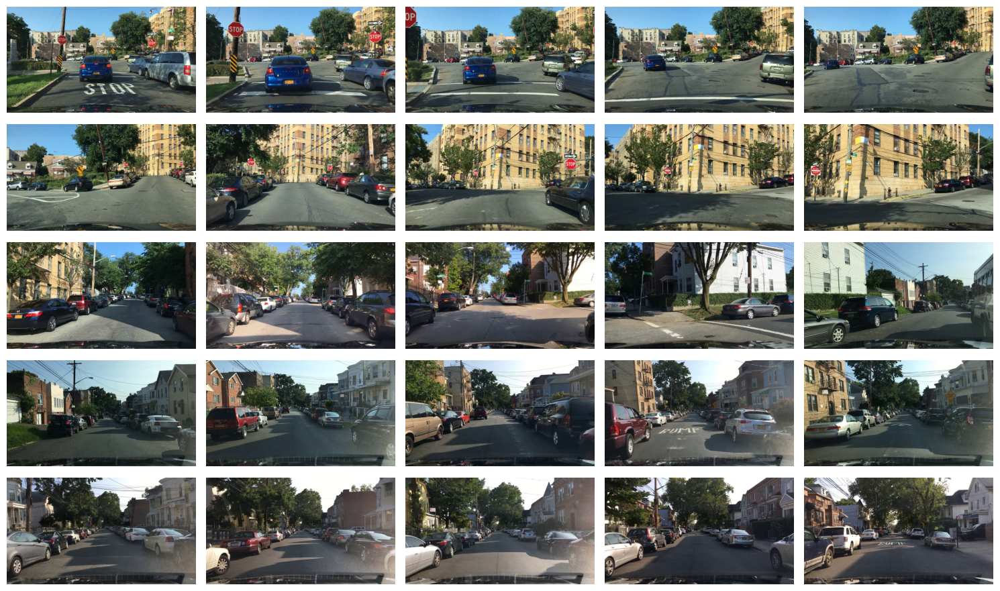

In [25]:
all_frames = get_frames_with_jump(data.videoName.iloc[0], 50)
multiple_frames_plot(all_frames)

---
# Add the bounding boxes to the video images:

In [26]:
# Exploring the metadata of a specific video: -----------------------------------------
first_video_name = data.videoName.iloc[0]
first_video_data = data.query(f'videoName == "{first_video_name}"') # query() filters using SQL-like syntax.
ipd.display(ipd.Markdown(f'#### **All the metadata of the first video:** {first_video_name}'))
ipd.display(first_video_data)

# Number of unique objects and categories per frame in the first video:
all_frames = first_video_data.groupby("frameIndex").nunique().reset_index()
all_frames = all_frames[['frameIndex', 'id', 'category']]
all_frames.columns = ['FrameIndex', 'NumObjects_per_Frame', 'NumCategories_per_Frame']
ipd.display(ipd.Markdown(f'#### **Relevant information per frame:**'))
all_frames

#### **All the metadata of the first video:** 00a2e3ca-5c856cde

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo
0,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000512,car,False,False,False,491.778291,717.090069,320.923788,512.147806,True
1,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000513,car,False,False,True,928.267898,1279.538106,298.475751,571.177829,True
2,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000514,car,False,True,False,816.027714,1029.699769,347.528868,474.734411,True
3,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000515,car,False,True,False,811.870670,948.221709,325.912240,408.221709,True
4,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000516,car,False,True,False,673.025404,751.177829,325.080831,367.482679,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3396,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000643,car,False,True,False,554.965358,588.221709,335.889145,378.290993,True
3397,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000644,car,False,True,False,693.810624,734.549654,350.023095,395.750577,True
3398,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000642,car,False,True,False,683.833718,733.718245,345.034642,389.930716,True
3399,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000641,car,False,True,False,676.351039,699.630485,346.697460,384.110855,True


#### **Relevant information per frame:**

,FrameIndex,NumObjects_per_Frame,NumCategories_per_Frame
0,0,27,2
1,1,27,2
2,2,28,2
3,3,28,2
4,4,29,2
...,...,...,...
197,197,17,1
198,198,17,1
199,199,16,1
200,200,15,1


**Observation:** The amount of frames of each video differs with the amount of frames in the metadata. This is because not all frames are labelled. Around <u>1 out of 6 frames</u> are labelled. Thus, we need to creat a new columns containing the real position of each frame inside the video.



#### **Supositions needed for this function to work:**
1. The labelled frames are evenly distributed.
2. the first and last labelled frames are the actual first and last frames of the video.
3. CAP_PROP_FRAME_COUNT is not too far from the actual number of frames in the video. 


In [27]:
""" This function gives us the approximate rate at which frames are labelled according to the metadata. """

""" Supositions needed for this function to work: 
    1. The labelled frames are evenly distributed.
    2. the first and last labelled frames are the actual first and last frames of the video.
    3. CAP_PROP_FRAME_COUNT is not too far from the actual number of frames in the video. """ 
    
    # NOTE: After generating the video, the frames look a little behind. That means that maybe suposition 2 is not completely true.
    #       So maybe this behavior can be improved assuming the last labelled frame does not fall at the end, but a few frames before.
    #       Then, the rate would be (total_frames - 1 - n) / (labelled_frames - 1), for n between 0 and 5. Change that in the future
    #       and check if the resulting video looks better.

def labelled_frames_rate(vid_name : str) -> float:
    vid_path = video_full_path(vid_name, 'mp4')
    capture = cv2.VideoCapture(vid_path)
    
    total_frames = int(capture.get(cv2.CAP_PROP_FRAME_COUNT))
    labelled_frames = data.query(f'videoName == "{vid_name}"')["frameIndex"].nunique()
    
    capture.release()
    
    # Avoid division by zero in the rare case a video has only 1 frame labelled:
    if labelled_frames <= 1:
        return 1
    
    # Instead of dividing N/M, we count the number of gaps between elements of the sequences, that is (N-1)/(M-1). In that way, the gaps of one sequence 
    # will get alineated with respect to the other's sequence, leading to the boundaries of the sequences match, allowing the sequences to align correctly.
    return (total_frames - 1) / (labelled_frames -1)

labelled_frames_rate(first_video_name)

5.990049751243781

Create a new column in the dataframe indicating the real position of each labelled frame inside the video:

In [28]:
data = data.copy()

rates = {vid_n: labelled_frames_rate(vid_n) for vid_n in data.videoName.unique()}

data['videoFrameIndex'] = (data['frameIndex'] * data['videoName'].map(rates) ).round().astype(int)

ipd.display(data.query(f'videoName == "{first_video_name}"')) # Example with the first video.

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo,videoFrameIndex
0,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000512,car,False,False,False,491.778291,717.090069,320.923788,512.147806,True,0
1,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000513,car,False,False,True,928.267898,1279.538106,298.475751,571.177829,True,0
2,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000514,car,False,True,False,816.027714,1029.699769,347.528868,474.734411,True,0
3,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000515,car,False,True,False,811.870670,948.221709,325.912240,408.221709,True,0
4,00a2e3ca-5c856cde-0000001.jpg,00a2e3ca-5c856cde,0,00000516,car,False,True,False,673.025404,751.177829,325.080831,367.482679,True,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3396,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000643,car,False,True,False,554.965358,588.221709,335.889145,378.290993,True,1204
3397,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000644,car,False,True,False,693.810624,734.549654,350.023095,395.750577,True,1204
3398,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000642,car,False,True,False,683.833718,733.718245,345.034642,389.930716,True,1204
3399,00a2e3ca-5c856cde-0000202.jpg,00a2e3ca-5c856cde,201,00000641,car,False,True,False,676.351039,699.630485,346.697460,384.110855,True,1204


In [29]:
data.category.unique()

array(['car', 'pedestrian', 'bus', 'rider', 'bicycle', 'motorcycle',
       'truck', None, 'other person'], dtype=object)

#### Colors by category:

In [30]:
color_map = {
    "car": (0, 255, 0),
    "truck": (0, 0, 100),
    "pedestrian": (255, 0, 0),
    "other vehicle": (0, 0, 150),
    "rider": (200, 0, 0),
    "bicycle": (0, 0, 255),
    "other person": (200, 0, 0),
    "trailer": (0, 150, 150),
    "motorcycle": (0, 150, 0),
    "bus": (0, 0, 100),
}

In [31]:
""" This function draws bounding boxes on the first n labelled frames of a video and displays them."""

def draw_boxes(vid_name : str, number_of_frames = 1500) -> tuple[list, list]: # 1500 is just a safe large number.
    video_df = data.query(f'videoName == "{vid_name}"') # .copy() is not needed since we are not modifying the dataframe, just reading from it.
    
    if video_df.category.isnull().any(): # Ignore frames in which no object was detected.
        video_df = video_df[video_df.category.notna()]
    
    vid_path = video_full_path(vid_name, 'mp4')
    capture = cv2.VideoCapture(vid_path)
    
    list_labelled, list_all = [], []
    # Persistent lists to store last drawn boxes for unlabelled frames:
    last_rectangles, last_categories, last_colors = [], [], []
    
    current_frame = 0
    
    while current_frame < number_of_frames:
        ret, img = capture.read()
        if not ret:
            break
        
        # Just the section of the df that contains the labelled frame metadata:
        curr_frame_df = video_df.query(f'videoFrameIndex == {current_frame}')
        
        if len(curr_frame_df) > 0:
               
            rectangles, categories, colors = [], [], []
            
            # This 'for' loop draws all boxes corresponding to the current frame. Exit the 'for' means all boxes were drawn.
            for _, row in curr_frame_df.iterrows():
                # Variables:
                x1, y1, x2, y2 = map(int, [row['box2d.x1'], row['box2d.y1'], row['box2d.x2'], row['box2d.y2']])
                category = row['category']
                color = color_map[category]
                # Add to lists (for the frames with no labels):
                rectangles.append((x1, y1, x2, y2))
                categories.append(category)
                colors.append(color)  
                # Draw box and label:
                cv2.rectangle(img, (x1, y1), (x2, y2), color, 2) 
                cv2.putText(img, category, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2) # args: (img, text, position, font, scale, color, thickness).
            
            # Save the boxes drawn for future unlabelled frames:
            last_rectangles, last_categories, last_colors = rectangles, categories, colors
            
            cv2.putText(img, "LABELLED", (10, 30), cv2.FONT_HERSHEY_COMPLEX, 1.2, (0,0,0), 3, cv2.LINE_AA) # Last arg: line type
            list_labelled.append(img)
            
        else: # This condition is met when the current frame IS NOT LABELLED.
            for (x1, y1, x2, y2), color, category in zip(last_rectangles, last_colors, last_categories):
                cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
                cv2.putText(img, category, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
        
        list_all.append(img)
        current_frame += 1
        
    capture.release()
    return list_labelled, list_all

#### Let's plot the results:

Number of labelled frames: 4
 Number of all frames: 20


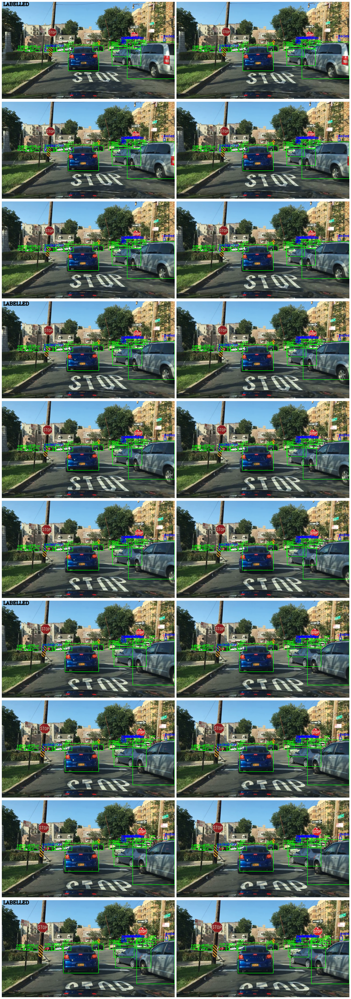

In [35]:
labelled, all = draw_boxes(first_video_name, 20)
print(f'Number of labelled frames: {len(labelled)}\n', f'Number of all frames: {len(all)}')
multiple_frames_plot(all, cols=2, length=20, figsize=(20, 55))

---
## Label and Output Annotated Video

In [83]:
""" This function writes a video with the boxes drawn on it. """
def video_with_labels(vid_name : str) -> Path:
    labelledd, all_frames = draw_boxes(vid_name, 1300) # Draw boxes on the first 50 labelled frames.
    
    # Define video writer
    vid_path = video_full_path(vid_name, 'mp4')
    output_path = vid_path.with_name(f"{vid_name}_labeled.mp4")
    height, width, _ = all_frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(str(output_path), fourcc, 20.0, (width, height))
    
    for frame in all_frames:
        out.write(frame)
    
    out.release()
    return output_path

In [ ]:
""" Run one time to creat the video with the boxes drawn on it. """
# path = video_with_labels(first_video_name)
# display_video(path)

#### **Video being display:** Data\bdd100k_videos_train_00\bdd100k\videos\train\00a2e3ca-5c856cde_labeled.mp4

#### Chechikng the videos with missing annotations:

In [84]:
miss_annotations_df(data)

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo,videoFrameIndex
13455,00a0f008-3c67908e-0000173.jpg,00a0f008-3c67908e,172,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1035
13456,00a0f008-3c67908e-0000174.jpg,00a0f008-3c67908e,173,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1041
13457,00a0f008-3c67908e-0000175.jpg,00a0f008-3c67908e,174,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1047
13458,00a0f008-3c67908e-0000176.jpg,00a0f008-3c67908e,175,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1053
13459,00a0f008-3c67908e-0000177.jpg,00a0f008-3c67908e,176,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1059
13460,00a0f008-3c67908e-0000178.jpg,00a0f008-3c67908e,177,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1065
13461,00a0f008-3c67908e-0000179.jpg,00a0f008-3c67908e,178,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1071
13462,00a0f008-3c67908e-0000180.jpg,00a0f008-3c67908e,179,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1077
13463,00a0f008-3c67908e-0000181.jpg,00a0f008-3c67908e,180,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1083
13464,00a0f008-3c67908e-0000182.jpg,00a0f008-3c67908e,181,None,None,None,None,None,NaN,NaN,NaN,NaN,True,1089


### There is 2 videos with missing annotations:

,videoName,#_missing,frameIndex
0,"(00a0f008-3c67908e,)",30,"[172, 173, 174, 175, 176, 177, 178, 179, 180, ..."
1,"(00a9cd6b-b39be004,)",10,"[121, 122, 123, 124, 125, 126, 127, 128, 129, ..."


In [ ]:
""" Run one time to creat the video with the boxes drawn on it. """
# path = video_with_labels('00a0f008-3c67908e')
# display_video(path)

# NOTE: There is a box at the end that remains in the screen even though there is no objects. Pending check and fix.

#### **Video being display:** ..\Data\bdd100k_videos_train_00\bdd100k\videos\train\00a0f008-3c67908e_labeled.mp4